# Assignment 1 (100 points)

### Imports for all questions

In [1]:
from collections import Counter
import math
import matplotlib.pyplot as plt
import numpy as np
import seaborn as sns
from nltk.util import ngrams
import re

### Question 1: Zipf’s law *(20 points)*

<p>Verify Zipf’s law on a textual corpus. The jungle book dataset is provided in the "Datasets and Resources" file. (You can also use any other dataset of your choice). <p>

<p> Provide a list of unique word sorted by their frequency in descending order. Also, give a brief discussion of the findings. You can use matplotlib library to plot the linear curve, and a log-log curve. The usage of other python modules is not permitted.</p>

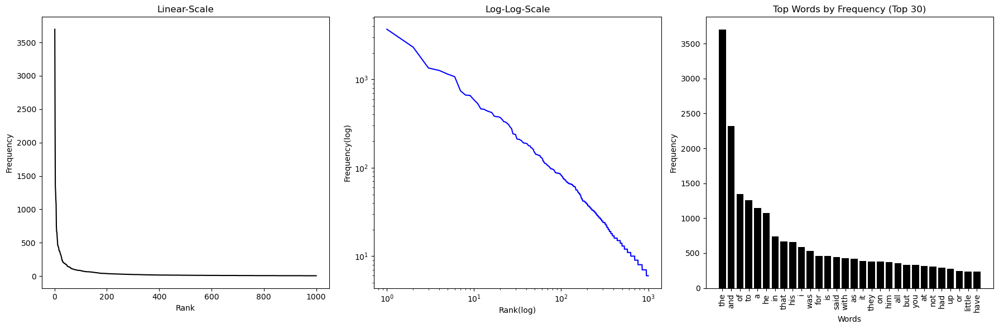

Top words by frequency:
the: 3697
and: 2321
of: 1347
to: 1262
a: 1147
he: 1074
in: 742
that: 665
his: 659
i: 587
was: 534
for: 463
is: 460
said: 442
with: 431
as: 422
it: 385
they: 379
on: 378
him: 370


In [2]:
def load_and_clean_text(filename):
    with open(filename, "r") as file:
        text = file.read().lower()
    text = re.sub(r'[^a-zA-Z0-9\s]','',text)
    return text.split()

def count_word_frequencies(words):
    return Counter(words)

def plot_word_frequencies(word_frequencies, top_n=1000):
    sorted_words = word_frequencies.most_common(top_n)
    frequencies = [pair[1] for pair in sorted_words]
    word_labels = [pair[0] for pair in sorted_words]
    ranks = list(range(1, len(frequencies) + 1))

    plt.figure(figsize=(18, 6))

    # Linear
    plt.subplot(1, 3, 1)
    plt.plot(ranks, frequencies, 'k-')
    plt.title("Linear-Scale")
    plt.xlabel("Rank")
    plt.ylabel("Frequency")

    # Log-log
    plt.subplot(1, 3, 2)
    plt.loglog(ranks, frequencies, 'b-')
    plt.title("Log-Log-Scale")
    plt.xlabel("Rank(log)")
    plt.ylabel("Frequency(log)")

    # Top 30
    plt.subplot(1, 3, 3)
    plt.bar(word_labels[:30], frequencies[:30], color='black')
    plt.title("Top Words by Frequency (Top 30)")
    plt.xlabel("Words")
    plt.ylabel("Frequency")
    plt.xticks(rotation=90)

    plt.tight_layout()
    plt.show()

def print_top_words(word_frequencies, n=20):
    print("Top words by frequency:")
    for word, freq in word_frequencies.most_common(n):
        print(f"{word}: {freq}")

words = load_and_clean_text("jungle_book.txt")
word_frequencies = count_word_frequencies(words)
plot_word_frequencies(word_frequencies)
print_top_words(word_frequencies)

There were not much differences for a further optimisation for this part.

### Question 2: Mutual Information *(30 points)*

Pointwise mutual information quantifies the statistical dependence between events ${x_{t} = w_{1} }$ and ${ x_{t+1} = w_{2}}$. ${C(w)}$ is the absolute frequency and ${N}$ is the size of the corpus. If the probability of the next word in the corpus (${w_{2}}$) is affected by the probability of the previous word (${w_{1}}$), then ${pmi(w_{1},w_{2}) = 0}$; else the pmi value is either positive or negative.

$$ pmi(w_{1},w_{2}) = log \frac{P(x_{t} = w_{1}, x_{t+1} = w_{2})} {P(x_{t} = w_{1}) . P(x_{t+1} = w_{2})} \approx log \frac {C(w_{1}w_{2}) . N} {C(w_{1}) . C(w_{2})}  $$

Calculate the Pointwise mutual information (PMI) for all successive word pairs $(w_1, w_2)$ in the jungle book corpus. Words (not word pairs) that occur in the corpus less than 10 times should be ignored. List the 30 word pairs with the highest pmi value and the 30 word pairs with the lowest pmi value. Document your observations and discuss the validity of the independence assumption for unigram models. If needed, you can use nltk library.

### My Code

In [3]:
word_frz = Counter(words)
bigrams = list(ngrams(words, 2))
word_pair_frz = Counter(bigrams)
total_words = len(words)

pmi_values = {}
for word_pair, freq in word_pair_frz.items():
    word1, word2 = word_pair
    freq_word1 = word_frz[word1]
    freq_word2 = word_frz[word2]
    p_word1_word2 = freq / total_words
    p_word1 = freq_word1 / total_words
    p_word2 = freq_word2 / total_words
    pmi = math.log2(p_word1_word2 / (p_word1 * p_word2))
    pmi_values[word_pair] = pmi

top_30_pmi = sorted(pmi_values.items(), key=lambda x: x[1], reverse=True)[:30]
bottom_30_pmi = sorted(pmi_values.items(), key=lambda x: x[1])[:30]

print("Top 30 word pairs with highest PMI:")
for pair, pmi in top_30_pmi:
    print(pair, pmi)

print("\n")

print("Bottom 30 word pairs with lowest PMI:")
for pair, pmi in bottom_30_pmi:
    print(pair, pmi)

Top 30 word pairs with highest PMI:
('dewaneethe', 'madnessand') 15.743729955357235
('snarly', 'singsong') 15.743729955357235
('truethat', 'maneaters') 15.743729955357235
('fullthroated', 'aaarh') 15.743729955357235
('howlan', 'untigerish') 15.743729955357235
('untigerish', 'howlfrom') 15.743729955357235
('marries', 'withdraw') 15.743729955357235
('rocka', 'hilltop') 15.743729955357235
('badgercolored', 'veterans') 15.743729955357235
('bitter', 'howls') 15.743729955357235
('redhot', 'charcoal') 15.743729955357235
('steelblue', 'rippingchisel') 15.743729955357235
('rippingchisel', 'talons') 15.743729955357235
('indignant', 'adding') 15.743729955357235
('thengreat', 'scholar') 15.743729955357235
('nut', 'turns') 15.743729955357235
('crossroads', 'uphills') 15.743729955357235
('arrula', 'whoo') 15.743729955357235
('arulala', 'wahooa') 15.743729955357235
('fantastic', 'knots') 15.743729955357235
('beautifully', 'mottled') 15.743729955357235
('snakein', 'fact') 15.743729955357235
('pss', 'n

### Optimised by ChatGPT part

In [4]:
# Count individual words and word pairs (bigrams)
word_frz = Counter(words)
bigrams = [bigram for bigram in ngrams(words, 2) if word_frz[bigram[0]] >= 10 and word_frz[bigram[1]] >= 10]
word_pair_frz = Counter(bigrams)
total_words = len(words)

# Precompute individual word probabilities
word_probabilities = {word: freq / total_words for word, freq in word_frz.items()}

# Calculate PMI values only for filtered bigrams
pmi_values = {}
for (word1, word2), freq in word_pair_frz.items():
    p_word1_word2 = freq / total_words
    p_word1 = word_probabilities[word1]
    p_word2 = word_probabilities[word2]
    pmi = math.log2(p_word1_word2 / (p_word1 * p_word2))
    pmi_values[(word1, word2)] = pmi

# Get top 30 and bottom 30 PMI scores
top_30_pmi = sorted(pmi_values.items(), key=lambda x: x[1], reverse=True)[:30]
bottom_30_pmi = sorted(pmi_values.items(), key=lambda x: x[1])[:30]

# Display results
print("Top 30 word pairs with highest PMI:")
for pair, pmi in top_30_pmi:
    print(pair, pmi)

print("\nBottom 30 word pairs with lowest PMI:")
for pair, pmi in bottom_30_pmi:
    print(pair, pmi)

Top 30 word pairs with highest PMI:
('machua', 'appa') 12.269798767024822
('literary', 'archive') 12.043290237216143
('united', 'states') 11.836839359748717
('darzees', 'wife') 11.421801860469872
('archive', 'foundation') 11.284298336719937
('cold', 'lairs') 11.059231781085163
('gutenberg', 'literary') 10.836839359748716
('stretched', 'myself') 10.684836266303666
('petersen', 'sahib') 10.60195599422907
('hind', 'legs') 10.396266768362734
('fore', 'paws') 10.284298336719937
('twenty', 'yoke') 10.196835495469598
('whole', 'line') 10.00676436119103
('electronic', 'works') 9.988842453193767
('hind', 'flippers') 9.962370241832575
('master', 'words') 9.936375033299631
('years', 'ago') 9.895733048802285
('bring', 'news') 9.869260837441095
('mans', 'cub') 9.84560956937645
('council', 'rock') 9.699335835998781
('black', 'panther') 9.696909098604241
('moon', 'rose') 9.684836266303666
('wolfs', 'cave') 9.547332742553731
('mothers', 'heart') 9.547332742553731
('brown', 'bear') 9.521337534020788
('

### Question 3: Wikipedia language model *(50 points)*

<p> A customer of yours is dissatisfied with the quality of the speech recognition. After a conversation with the customer, you find out that he dictates books. The initial investigations on a book excerpt have shown that the language model used is not suitable. For building a better language model for the application, you have asked your customer to provide a text from the book (see "Datasets and Resources") </p>

<p> In order to save costs and also to avoid problems with copyrights, your company has decided not to use existing solutions for this project. So, you have to implement a 2-gram language model in Python from scratch. Include a short description of the data preprocessing steps, method, experiment design, hyper-parameters, and evaluation metric. Also, document your findings, drawbacks, and potential improvements. Finally, compare the performance of the language model with and without Backoff.</p>

<p> You cannot use any Python libraries like NLTK. If you need to use special Python modules, you can discuss with your instructor before submission. </p>

<h4> Datasets and Resources </h4> 

* WikiText-2 (raw/unprocessed), Train, Dev, Test

### Question 3: 
#### Data Preprocessing

1. **File Loading Function:**
   
    I am developing a function named `load_file` to retrieve text content from a specified file efficiently. By supplying the file path as input, this function quickly fetches the text, simplifying access and further processing of the data.

In [5]:
def load_file(file_path):
    with open(file_path, "r") as file:
        text = file.read()
    return text

2. **Sentence Splitting Function:**
   
   I am developing a function named `split_into_sentences` to segment a block of text into individual sentences. Given a text block, this function identifies periods followed by spaces to partition it into distinct sentences, returning an organised list for easy analysis or processing.

In [6]:
def split_into_sentences(text):
  sentences = []
  current_sentence = ""
  for char in text:
    if char in ".?!;":  
      current_sentence = current_sentence.strip() 
      if current_sentence:
        sentences.append(current_sentence)
      current_sentence = ""
    else:
      current_sentence += char
  if current_sentence:  
    sentences.append(current_sentence.strip())
  return sentences

3. **Word Tokenisation Function:**
   
   This time with a function named `tokenise`, using it to segment a sentence into individual words. Given a sentence, this function precisely separates it into distinct words, returning a well-organised list ready for further processing or analysis

In [7]:
def tokenise(sentence):
    words = re.findall(r'\b\w+\b', sentence)
    return words

4. Word Normalisation Function:
   
   Here, am developing a normalisation function to tidy a list of words. This function standardises each word by converting it to lowercase and removing non-alphanumeric characters, delivering a refined list ready for further processing or analysis.

In [8]:
def normalise(words):
    normalised_words = [word.lower() for word in words if word.isalnum()]
    return normalised_words


5. Sentence Decoration Function: 
   
   Developing a function named `add_start_end_symbols` to prepare sentences for analysis. This function adds `<s>` at the start and `</s>` at the end of each sentence in a list, enhancing their readiness for linguistic exploration. It returns the marked sentences, ready for further linguistic analysis

In [9]:
def add_start_end_symbols(sentences):
    start_symbol = "<s>"
    end_symbol = "</s>"
    sentences_with_symbols = [[start_symbol] + sentence + [end_symbol] for sentence in sentences]
    return sentences_with_symbols

6. Training a 2-gram Language Model:
   
   Here, made a function named `train_2gram_model` to build a 2-gram language model. This function processes a list of sentences to learn typical word sequences, counting each pair of adjacent words and storing this information in a dictionary-like model. After processing all sentences, the function returns the trained 2-gram model, equipping it with an understanding of language flow for text generation or prediction.

In [10]:
def train_2gram_model(sentences):
    model = {}
    for sentence in sentences:
        for i in range(len(sentence) - 1):
            current_word = sentence[i]
            next_word = sentence[i + 1]
            if current_word not in model:
                model[current_word] = {}
            if next_word not in model[current_word]:
                model[current_word][next_word] = 0
            model[current_word][next_word] += 1
    return model

7. Estimating Probabilities:
   
   In the `estimate_probabilities` function, it calculates the probabilities of each word following another in the 2-gram language model. Using word transitions from the trained model, the function iterates over each word and its successors. For each word, it calculates the total count of following words and divides each successor’s count by this total, creating a probability distribution that shows the likelihood of specific word sequences. The function returns these probabilities as a dictionary-like structure, ready for various language modelling tasks.

In [11]:
def estimate_probabilities(model):
    probabilities = {}
    for current_word, next_words in model.items():
        total_count = sum(next_words.values())
        probabilities[current_word] = {next_word: count / total_count for next_word, count in next_words.items()}
    return probabilities

8. Laplace Smoothing: 
   
   The `laplace_smoothing` function applies smoothing to a 2-gram model, giving all word pairs a small probability, even unobserved ones. Using a smoothing parameter  $\alpha$  (default 1), it calculates a total count for each word’s successors and assigns smoothed probabilities. This ensures a robust model with probabilities for unseen transitions.

In [12]:
def laplace_smoothing(model, alpha=1):
    smoothed_model = {}
    vocabulary_size = len(model) 
    for current_word, next_words in model.items():
        total_count = sum(next_words.values()) + (vocabulary_size * alpha)
        smoothed_model[current_word] = {next_word: (count + alpha) / total_count for next_word, count in next_words.items()}
    return smoothed_model

9. Splitting the Dataset:
    
    In the `split_dataset` function, I divide the dataset into training, validation, and test subsets, each serving a unique purpose. Given the dataset and optional proportions for each set (defaulting to 70%, 15%, and 15%), the function calculates subset sizes based on these ratios. It then partitions the data accordingly: the first portion goes to the training set, the next to the validation set, and the remainder to the test set. The function returns these three subsets, ready for training, validation, and evaluation.

In [13]:
def split_dataset(data, train_ratio=0.7, val_ratio=0.15, test_ratio=0.15):
    if train_ratio + val_ratio + test_ratio != 1:
        raise ValueError("Sum of ratios must equal 1. Provided values: train_ratio={}, val_ratio={}, test_ratio={}".format(
            train_ratio, val_ratio, test_ratio))

    train_size = int(len(data) * train_ratio)
    val_size = int(len(data) * val_ratio)
    test_data = data[train_size + val_size:]
    val_data = data[train_size:train_size + val_size]
    train_data = data[:train_size]

    return train_data, val_data, test_data

10. Crafting a Unigram Language Model:
    
    In the `train_1gram_model` function, I create a unigram language model based on a corpus of sentences. Using Python’s Counter class, this function efficiently counts word occurrences across all sentences, establishing their frequency distribution. For each word, the function calculates its probability by dividing its count by the total word count, resulting in a probability distribution for each word. This unigram model provides foundational insights into word distribution, supporting tasks such as text generation and prediction in language modelling.

In [14]:
def train_1gram_model(sentences):
    unigram_model = Counter()
    for sentence in sentences:
        unigram_model.update(sentence)
    total_count = sum(unigram_model.values())
    unigram_model = {word: count / total_count for word, count in unigram_model.items()}
    return unigram_model

11. Computing Perplexity:
    
    In the `train_1gram_model` function, I create a unigram language model based on a corpus of sentences. Using Python’s Counter class, this function efficiently counts word occurrences across all sentences, establishing their frequency distribution. For each word, the function calculates its probability by dividing its count by the total word count, resulting in a probability distribution for each word. This unigram model provides foundational insights into word distribution, supporting tasks such as text generation and prediction in language modelling.

In [15]:
def calculate_perplexity(model, data, model_1gram=None):
    total_log_probability = 0
    total_words = 0
    for sentence in data:
        for i in range(len(sentence) - 1):
            current_word = sentence[i]
            next_word = sentence[i + 1]

            if current_word in model:
                if next_word in model[current_word]:
                    total_log_probability += -math.log(model[current_word][next_word])
                else:
                    if model_1gram is not None:
                        if next_word in model_1gram:
                            total_log_probability += -math.log(model_1gram[next_word])
                        else:
                            pass
                    else:
                        pass

            total_words += 1

    perplexity = math.exp(total_log_probability / total_words)
    return perplexity

12. Hyperparameter Tuning:
    
    The `tune_hyperparameters` function searches for the optimal smoothing parameter ($\alpha$) by testing various values to find the one that yields the lowest perplexity on validation data. This process is akin to fine-tuning a radio for the clearest signal. Given training and validation data, the function loops through a range of $\alpha$ values (e.g., [0.1, 0.01, 0.001]), applying Laplace smoothing to create a 2-gram model for each $\alpha$. It then calculates each model’s perplexity on the validation data. If a model’s perplexity is lower than previous values, the function updates the best model and $\alpha$. Ultimately, it returns the best model along with the optimal $\alpha$.

In [16]:
def tune_hyperparameters(train_data, val_data, test_data):
    best_model = None
    best_perplexity = float('inf')
    val_perplexity_values = []
    test_perplexity_values = []
    model_1gram = train_1gram_model(train_data)
    alpha_values = [0.1, 0.01, 0.001]
    

    for alpha in alpha_values:
        print("Testing alpha:", alpha)
        smoothed_model = laplace_smoothing(train_2gram_model(train_data), alpha)

        val_perplexity = calculate_perplexity(smoothed_model, val_data, model_1gram)  
        print("Perplexity for alpha", alpha, "on validation data:", val_perplexity)
        val_perplexity_values.append(val_perplexity)
        
        test_perplexity = calculate_perplexity(smoothed_model, test_data)  
        print("Perplexity for alpha", alpha, "on test data:", test_perplexity)
        test_perplexity_values.append(test_perplexity)
        
        if val_perplexity < best_perplexity:
            best_perplexity = val_perplexity
            best_model = smoothed_model
    
    if best_model is None:
        print("No best model found. Please check the hyperparameter tuning process.")

    print("Validation Perplexity Values:", val_perplexity_values)
    print("Test Perplexity Values:", test_perplexity_values)
    
    print("\nBest Model Perplexity (on validation data):", best_perplexity)
    print("Best model:", best_model)
    
    return best_model, best_perplexity, test_perplexity_values


13. Training 2-gram Model with Backoff:
    
    The `train_2gram_model_with_backoff` function constructs a 2-gram language model with backoff, using the provided sentences. It first calls the `train_2gram_model` function to build a standard 2-gram model and then uses `train_1gram_model` to create a unigram model from the same sentences. The function returns both models as a tuple, enabling backoff: the 2-gram model is used primarily, but if a bigram is missing, it falls back on the unigram model for probability estimation.

In [17]:
def train_2gram_model_with_backoff(sentences):
    model = train_2gram_model(sentences)
    unigram_model = train_1gram_model(sentences)
    return model, unigram_model

14. **Backoff in Language Modelling:** 

  **Formula:** The probability of encountering a word $(w_n)$ given its predecessor $(w_{n-1})$ is computed using a nuanced formula:
    
  $P(w_n | w_{n-1}) =$
  $\begin{cases}
  \frac{C(w_{n-1}w_n)}{C(w_{n-1})} & \text{if } C(w_{n-1}w_n) > 0 \\
  \alpha \cdot P(w_n) & \text{otherwise}
  \end{cases}$


- \( $P(w_n | w_{n-1})$ \): Probability of word \( $w_n$ \) given word \( $w_{n-1}$ \)
- \( $C(w_{n-1}w_n)$ \): Count of the bigram \( $w_{n-1}w_n$ \) in the training data
- \( $C(w_{n-1})$ \): Count of occurrences of word \( $w_{n-1}$ \) in the training data
- \( $P(w_n)$ \): Probability of word \( $w_n$ \) based on a simpler model (e.g., unigram model)
- \( $\alpha$ \): Smoothing parameter for backoff

In [18]:
train_text = load_file("wiki.train.raw")
train_sentences = split_into_sentences(train_text)
train_tokenised = [tokenise(sentence) for sentence in train_sentences]
train_normalised = [normalise(words) for words in train_tokenised]
train_data = add_start_end_symbols(train_normalised)

val_text = load_file("wiki.valid.raw")
val_sentences = split_into_sentences(val_text)
val_tokenised = [tokenise(sentence) for sentence in val_sentences]
val_normalised = [normalise(words) for words in val_tokenised]
val_data = add_start_end_symbols(val_normalised)

test_text = load_file("wiki.test.raw")
test_sentences = split_into_sentences(test_text)
test_tokenised = [tokenise(sentence) for sentence in test_sentences]
test_normalised = [normalise(words) for words in test_tokenised]
test_data = add_start_end_symbols(test_normalised)

best_model, val_perplexity, test_perplexity = tune_hyperparameters(train_data, val_data, test_data)

Testing alpha: 0.1
Perplexity for alpha 0.1 on validation data: 869.3817930860229
Perplexity for alpha 0.1 on test data: 66.94775432467384
Testing alpha: 0.01
Perplexity for alpha 0.01 on validation data: 432.60209143988345
Perplexity for alpha 0.01 on test data: 33.80873853749468
Testing alpha: 0.001
Perplexity for alpha 0.001 on validation data: 299.58929824675903
Perplexity for alpha 0.001 on test data: 23.610054309420335
Validation Perplexity Values: [869.3817930860229, 432.60209143988345, 299.58929824675903]
Test Perplexity Values: [66.94775432467384, 33.80873853749468, 23.610054309420335]

Best Model Perplexity (on validation data): 299.58929824675903
Best model: {'<s>': {'valkyria': 5.701428014477865e-05, 'vision': 4.5613704231005676e-05, 'released': 0.00015961946336873542, 'employing': 2.2812552403459724e-05, 'the': 0.16380348612966603, 'while': 0.004982063074894703, 'character': 0.00010261658379987054, 'a': 0.01803572249616476, 'it': 0.0285242523368359, 'after': 0.011913613230

### Optimised version for 3. Question by ChatGPT

In [19]:
# Optimised Preprocessing Pipeline
#def preprocess_text(file_path, min_word_length=1):
#    tokenised_sentences = []
    
    # Define regex patterns for splitting and cleaning
#    sentence_pattern = re.compile(r'[.!?;]\s*')  # Pattern for sentence-ending punctuation
#    word_pattern = re.compile(r'\b\w+\b')  # Pattern to capture words
    
    # Read and process the file line by line
#    with open(file_path, "r") as file:
#        for line in file:
#            line = line.lower()  # Convert to lowercase
#            line = re.sub(r'[^a-zA-Z0-9\s.!?]', '', line)  # Remove unwanted characters
            
            # Split into sentences based on punctuation
#            sentences = sentence_pattern.split(line)
#            for sentence in sentences:
                # Tokenise and filter by minimum word length
#                words = [word for word in word_pattern.findall(sentence) if len(word) >= min_word_length]
                
#                if words:  # Only add non-empty sentences
#                    tokenised_sentences.append(words)
    
#    return tokenised_sentences

# Bigram Model Training with Smoothing
#def train_bigram_model(tokenised_sentences, alpha=1):
#    unigram_counts = Counter()
#    bigram_counts = Counter()

    # Count unigrams and bigrams
#    for sentence in tokenised_sentences:
#        unigram_counts.update(sentence)
#        bigram_counts.update(zip(sentence, sentence[1:]))  # Generate bigrams
    
#    total_words = sum(unigram_counts.values())
#    vocabulary_size = len(unigram_counts)

    # Calculate bigram probabilities with smoothing
#    bigram_probabilities = defaultdict(float)
#    for (w1, w2), bigram_count in bigram_counts.items():
#        p_w2_given_w1 = (bigram_count + alpha) / (unigram_counts[w1] + alpha * vocabulary_size)
#        bigram_probabilities[(w1, w2)] = p_w2_given_w1
    
#    return bigram_probabilities, unigram_counts, vocabulary_size, total_words

# Text Generation Using the Bigram Model
#def generate_text(bigram_probabilities, unigram_counts, start_word, num_words=10):
#    current_word = start_word
#    generated_text = [current_word]
    
#    for _ in range(num_words - 1):
        # Get possible next words and their probabilities
#        candidates = {w2: prob for (w1, w2), prob in bigram_probabilities.items() if w1 == current_word}
        
#        if candidates:
            # Choose the next word based on probabilities
#            next_word = max(candidates, key=candidates.get)
#            generated_text.append(next_word)
#            current_word = next_word
#        else:
#            break  # End generation if no candidates
    
#    return ' '.join(generated_text)

# Perplexity Calculation
#def calculate_perplexity(bigram_probabilities, tokenised_sentences, unigram_counts, vocabulary_size, alpha=1):
#    total_log_prob = 0
#    total_bigrams = 0
    
#    for sentence in tokenised_sentences:
#        for w1, w2 in zip(sentence, sentence[1:]):
            # Retrieve bigram probability with Laplace smoothing
#            bigram_count = bigram_probabilities.get((w1, w2), 0)
#            unigram_count = unigram_counts.get(w1, 0)
#            p_w2_given_w1 = (bigram_count + alpha) / (unigram_count + alpha * vocabulary_size)
            
            # Accumulate log probability and bigram count
#            total_log_prob += math.log(p_w2_given_w1)
#            total_bigrams += 1
    
    # Calculate perplexity
#    perplexity = math.exp(-total_log_prob / total_bigrams)
#    return perplexity

# Example Workflow
# Preprocess data
#train_data = preprocess_text("wiki.train.raw")
#val_data = preprocess_text("wiki.valid.raw")
#test_data = preprocess_text("wiki.test.raw")

# Train bigram model
#bigram_probabilities, unigram_counts, vocabulary_size, total_words = train_bigram_model(train_data)

# Generate text example
#print("Generated Text:", generate_text(bigram_probabilities, unigram_counts, start_word="the", num_words=10))

# Evaluate model perplexity
#val_perplexity = calculate_perplexity(bigram_probabilities, val_data, unigram_counts, vocabulary_size)
#test_perplexity = calculate_perplexity(bigram_probabilities, test_data, unigram_counts, vocabulary_size)
#print("Validation Perplexity:", val_perplexity)
#print("Test Perplexity:", test_perplexity)

### Additional Experiments *(5 additional points - <span style="color: red;">Optional</span>)*

I tried smoothing, but I am not sure if that worked well...\
*I was going to try UNK words, which you can see where found the idea from one of the stackoverflow links (it must be the last one), but I went for this one, I also got a little bit of help from ChatGPT, to finish my code. Because I was having some errors.*\
*hope you dont mind.. hehe* ^^°\
ps. I will write more comments in the future, I just don't like writing comments, and am not used to it; and will check the resources to make my work more readable and practical.

Alpha: 0.1 Validation Perplexity: 3601.684384991659
Alpha: 0.3 Validation Perplexity: 3594.1174398472767
Alpha: 0.5 Validation Perplexity: 3677.5869016478546
Alpha: 1 Validation Perplexity: 3861.1736452682217
Alpha: 2 Validation Perplexity: 4101.765788869008


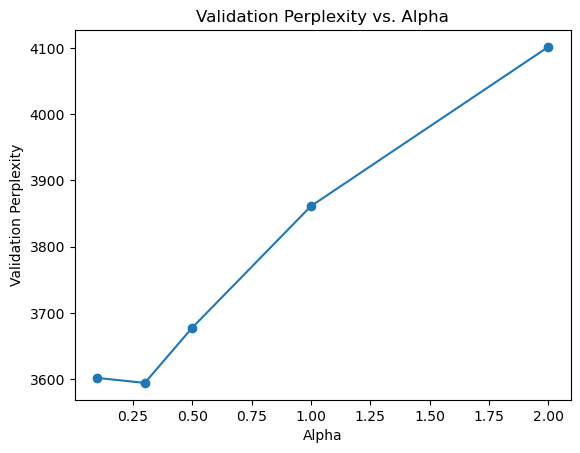

Optimal alpha: 0.3 with lowest validation perplexity: 3594.1174398472767


In [20]:
alpha_values = [0.1, 0.3, 0.5, 1, 2]
perplexities = []

for alpha in alpha_values:
    unigram_counts = Counter(words)
    bigram_counts = Counter(zip(words, words[1:]))
    vocabulary_size = len(unigram_counts)
    total_words = sum(unigram_counts.values())

    bigram_probabilities = {}
    for (w1, w2), bigram_count in bigram_counts.items():
        p_w2_given_w1 = (bigram_count + alpha) / (unigram_counts[w1] + alpha * vocabulary_size)
        bigram_probabilities[(w1, w2)] = p_w2_given_w1

    total_log_prob = 0
    total_bigrams = 0

    for sentence in val_data:
        for w1, w2 in zip(sentence, sentence[1:]):
            if (w1, w2) in bigram_probabilities:
                p_w2_given_w1 = bigram_probabilities[(w1, w2)]
            else:
                p_w2_given_w1 = alpha / (unigram_counts.get(w1, 0) + alpha * vocabulary_size)
            total_log_prob += math.log(p_w2_given_w1)
            total_bigrams += 1

    val_perplexity = math.exp(-total_log_prob / total_bigrams)
    perplexities.append(val_perplexity)
    print("Alpha:", alpha, "Validation Perplexity:", val_perplexity)

plt.plot(alpha_values, perplexities, marker='o')
plt.title("Validation Perplexity vs. Alpha")
plt.xlabel("Alpha")
plt.ylabel("Validation Perplexity")
plt.show()

optimal_alpha = alpha_values[perplexities.index(min(perplexities))]
print("Optimal alpha:", optimal_alpha, "with lowest validation perplexity:", min(perplexities))

### Sources

- https://stackoverflow.com/questions/71999817/nltk-is-installed-but-nltk-utils-returns-modulenotfounderror/72001540#72001540

- https://stackoverflow.com/questions/43463792/what-is-the-difference-between-bigram-and-unigram-text-features-extraction/60064994#60064994

- https://www.scaler.com/topics/nlp/backoff-in-nlp/

- https://stackoverflow.com/questions/6686758/package-to-generate-n-gram-language-models-with-smoothing-alternatives-to-nltk 

- https://stackoverflow.com/questions/43885252/unknown-words-in-n-gram-modelling

- ChatGPT (mostly for optimisation and checking when an error occurs)